In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import cv2
import numpy as np
import numpy.linalg as npl
from matplotlib import pyplot as plt
from matplotlib import cbook
import ipywidgets as widgets
import time
import timeit

In [3]:
from helpers import *

In [4]:
EXAMPLE_DIR = 'church'
DEPTH_RES = 128
ON_SURFACE = False
PRINT_DEBUG = True

In [5]:
image = cv2.imread(f'./data/{EXAMPLE_DIR}/input.png')
depth = cv2.imread(f'./data/{EXAMPLE_DIR}/depth_metric_r20.png', cv2.IMREAD_ANYDEPTH)
normals = cv2.imread(f'./data/{EXAMPLE_DIR}/normals.png')
shading = cv2.imread(f'./data/{EXAMPLE_DIR}/ours_shd.png')
albedo = cv2.imread(f'./data/{EXAMPLE_DIR}/ours_alb.png')

# Preprocessing
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image = image / np.max(image)

depth = np.array(depth / np.max(depth) * DEPTH_RES, dtype='uint8')
depth = DEPTH_RES - depth

# normals = cv2.cvtColor(normals, cv2.COLOR_BGR2RGB)
normals = ((normals / np.max(normals)) * 2) - 1

albedo = cv2.cvtColor(albedo, cv2.COLOR_BGR2RGB)
albedo = albedo / np.max(albedo)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 0.98, 'Mid Level Decomposition for "church"')

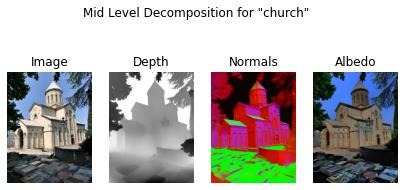

In [6]:
# Display image and mid-level image representations
fig, ax = plt.subplot_mosaic([['image', 'depth', 'normals', 'albedo']], figsize=(7, 3.5))
ax['image'].imshow(image)
ax['image'].axis('off')
ax['image'].set_title('Image')

ax['depth'].imshow(depth, cmap='gray')
ax['depth'].axis('off')
ax['depth'].set_title('Depth')

ax['normals'].imshow(normals)
ax['normals'].axis('off')
ax['normals'].set_title('Normals')

ax['albedo'].imshow(albedo)
ax['albedo'].axis('off')
ax['albedo'].set_title('Albedo')

fig.suptitle(f'Mid Level Decomposition for "{EXAMPLE_DIR}"')

## Refactor of **create_meshgrid**

In [7]:
# Refactored meshgrid, returns a flattened 2D RGB image, where R=x-coordinate, G=y-coordinate, B=z-coordinate
def create_flat_vector_field(depth_map, z_axis_resolution=128, return_full=False):
    if np.max(depth_map) != z_axis_resolution and np.min(depth_map) != 0:
        print(f"This should not print!")
        # Note: depth_map should be read using "cv2.imread('.', cv2.IMREAD_ANYDEPTH)"
        depth_map = np.array(depth_map / np.max(depth_map) * z_axis_resolution, dtype='uint8')
        depth_map = z_axis_resolution - depth_map  # Convert disparity map to depth map
    depth_map_x_dim, depth_map_y_dim = depth_map.shape
    x = np.arange(0, depth_map_x_dim)
    y = np.arange(0, depth_map_y_dim)
    z = np.arange(0, z_axis_resolution)

    xx, yy, zz = np.meshgrid(x, y, z, sparse=True)

    dense_x = np.ones((depth_map_y_dim, depth_map_x_dim, z_axis_resolution)) * xx
    dense_y = np.ones((depth_map_y_dim, depth_map_x_dim, z_axis_resolution)) * yy
    dense_z = np.ones((depth_map_y_dim, depth_map_x_dim, z_axis_resolution)) * zz

    vector_field = np.stack((dense_y, dense_x, dense_z), axis=-1)
    flat_vector_field = np.zeros((depth_map_y_dim, depth_map_x_dim, 3))
    # Works up to here
    for i in range(depth_map_y_dim):
        for j in range(depth_map_x_dim):
            d = depth[j, i] - 1
            v = vector_field[i, j, d]
            flat_vector_field[i, j] = v
    if return_full:
        return flat_vector_field, vector_field
    return flat_vector_field

In [8]:
# Tests for flat vector field
fvf = create_flat_vector_field(depth)
depth_map = depth - 1
test_coords = [[5, 5, depth_map[5, 5]], [715, 220, depth_map[715, 220]], [100, 100, depth_map[100, 100]], [550, 350, depth_map[550, 350]]]
print(test_coords)
print(fvf[5, 5], fvf[715, 220], fvf[100, 100], fvf[550, 350])

[[5, 5, 41], [715, 220, 82], [100, 100, 41], [550, 350, 75]]
[ 5.  5. 41.] [715. 220. 127.] [100. 100.  41.] [550. 350.  75.]


In [9]:
t0 = time.perf_counter()
flat_vec_field = create_flat_vector_field(depth)
t1 = time.perf_counter()
print(f"Meshgrid created in {t1-t0} seconds")

Meshgrid created in 8.848062700000014 seconds


## Refactor **get_surface_lighting** + **unit_direction_3D**

In [10]:
def point_light_3d(point, vector_field, attenuation_coef1=0.005, attenuation_coef2=0.05):
    directions_grid = vector_field - point
    magnitude = np.linalg.norm(directions_grid, axis=2)
    unit_direction_grid = directions_grid / magnitude[..., np.newaxis]
    magnitude_expanded = np.dstack([magnitude, magnitude, magnitude])
    attenuated_light = unit_direction_grid / (1 + attenuation_coef1 * magnitude_expanded + (attenuation_coef2 * 0.01 * magnitude_expanded**2))
    unit_direction_grid = np.swapaxes(unit_direction_grid, 0, 1)
    attenuated_light = np.swapaxes(attenuated_light, 0, 1)
    return unit_direction_grid, attenuated_light, magnitude


In [11]:
light_origin = np.array([250, 250, 5])

# Hardcoded shortcut to place light just on top of surface
if ON_SURFACE:
    light_origin[2] = depth[light_origin[0], light_origin[1]] - 16

t0 = time.perf_counter()
light_vector_field, attenuated_light ,light_magnitude_field = point_light_3d(light_origin, flat_vec_field)
t1 = time.perf_counter()
print(f"Vector field and Magnitude field created in {t1-t0} seconds")
print(f"{flat_vec_field[500, 250]}")

t0 = time.perf_counter()
relit_image = apply_surface_lighting(attenuated_light, light_magnitude_field, normals, albedo, light_colour=[1, 1, 1])
t1 = time.perf_counter()
print(f"Image relit in {t1-t0}")

Vector field and Magnitude field created in 0.12172350000003007 seconds
[500. 250.  73.]
Image relit in 0.10501389999996036


## Refactor of **apply_surface_lighting**

In [12]:
def calculate_shading(light_vectors, normals, light_colour=None):
    if light_colour is None:
        light_colour = [1, 1, 1]
    light_direction_times_normals = light_vectors * normals

    new_shading = np.sum(light_direction_times_normals, axis=2) / 3
    new_shading = np.dstack([new_shading, new_shading, new_shading]) * light_colour
    return new_shading

def apply_shading(shading, albedo, intensity=5):
    shading = shading * intensity

    new_image = shading * albedo
    return new_image

## Relighting starts here!

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


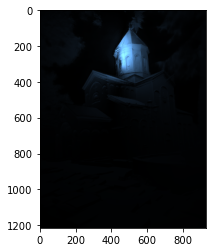

In [13]:
# light colour, one for the point light, one for the ambient colour
colour = [0.38, 0.631, 0.902] # light blue
ambient_colour = [0.035, 0.047, 0.161]

# CREATE POINT LIGHTS

# light coordinates
x = 450
y = 150
z = 100
lights = np.array([
    [x, y, z], 
    [x, y + 50, z], 
    [x, y + 100, z], 
    [x, y + 150, z], 
])

shadings = []
shading_sum = np.zeros_like(image).astype('float64')

for light in lights:
    light_vectors = point_light_3d(light, flat_vec_field)[1]
    shading = calculate_shading(light_vectors, normals, colour)
    shading_sum += np.abs(shading)

new_image = apply_shading(shading_sum, albedo, intensity=15)

#f = plt.figure()
#f.set_dpi(240)
#plt.axis('off')
plt.imshow(shading_sum * 5)

In [14]:
# AMBIENT LIGHT

path = (f'./data/{EXAMPLE_DIR}/')
img = plt.imread(path + 'input.png')

# Get the lights for each direction we want to use for ambient light
top_light = get_new_light_dir([0, -1, 0], img)
bottom_light = get_new_light_dir([0, 1, 0.3], img)
right_light = get_new_light_dir([1, 0.3, 0.4], img)
left_light = get_new_light_dir([-1, 0.3, 0.4], img)

# Get the shading with each new light direction
top_shading = get_shading(top_light, path, ambient_colour)
bottom_shading = get_shading(bottom_light, path, ambient_colour)
right_shading = get_shading(left_light, path, ambient_colour)
left_shading = get_shading(right_light, path, ambient_colour)

C:\Users\anial\Desktop\school\cmpt461\project\helpers.py:89: RuntimeWarning: invalid value encountered in power
  new_image = new_image ** 0.4545  # gamma correct
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


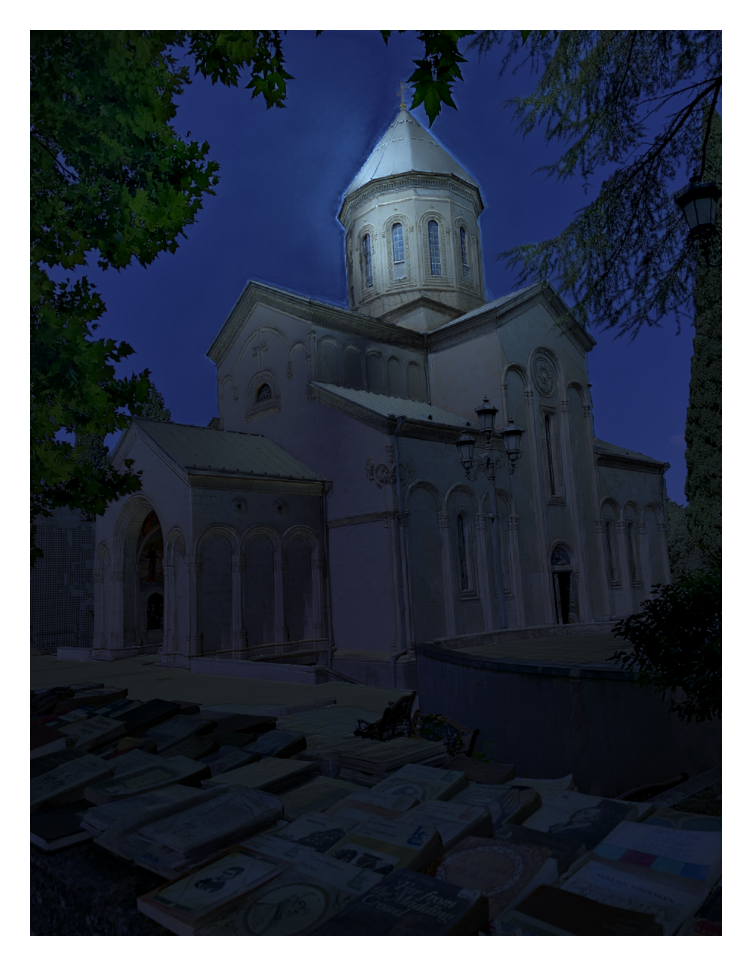

In [15]:
# COMBINE AMBIENT AND POINT LIGHTS

shading = [top_shading, bottom_shading, right_shading, left_shading, shading_sum]
multipliers = [0.35, 0.2, 0.4, 0.2, 4]
#multipliers = [0.15, 0.05, 0.05, 0.15, 0.6]

shading = combine_shading(shading, multipliers)

# Finally, create the image
new_image = get_image(shading, path)

f = plt.figure()
f.set_dpi(300)
plt.axis('off')
plt.imshow(new_image)

## Interpolation
Useful if you want to make a sequence of images to compose into a video or a gif. The interpolation function will interpolate over arrays of: colors, light positions, multipliers for the arrays

In [673]:
def interpolate(start, end, timestep):
    result = []
    for i in range(len(start)):
        elem = (timestep * start[i]) + (1 - timestep) * end[i]
        result.append(elem)
        
    return result

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

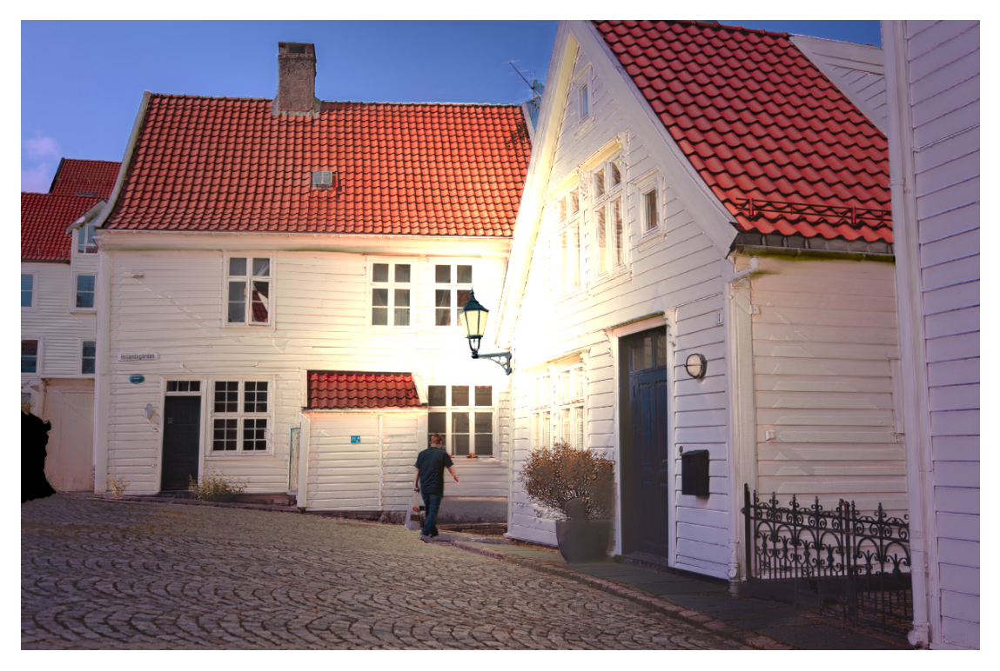

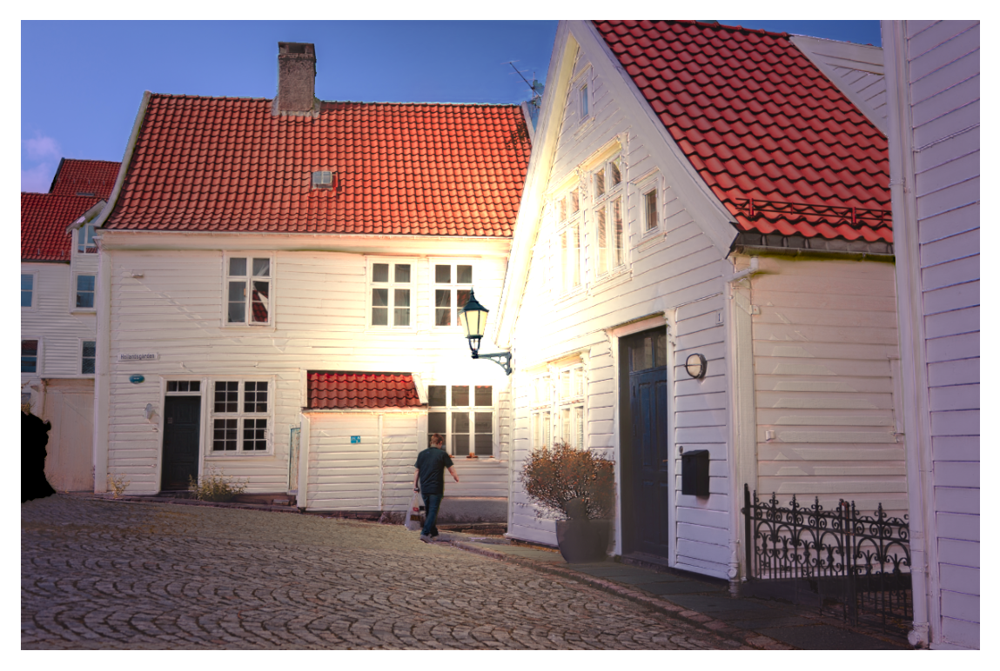

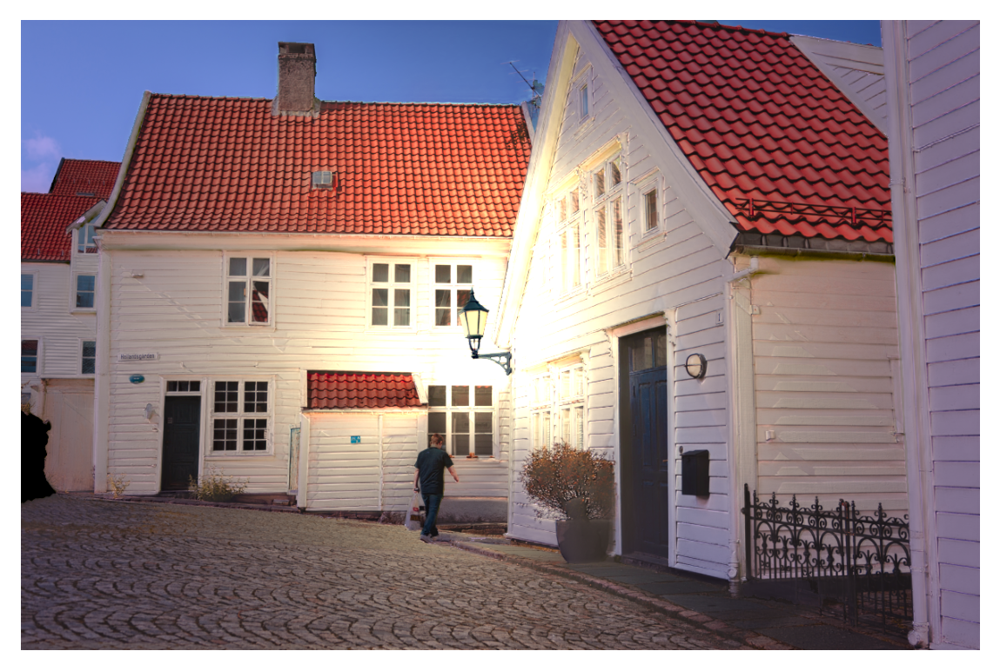

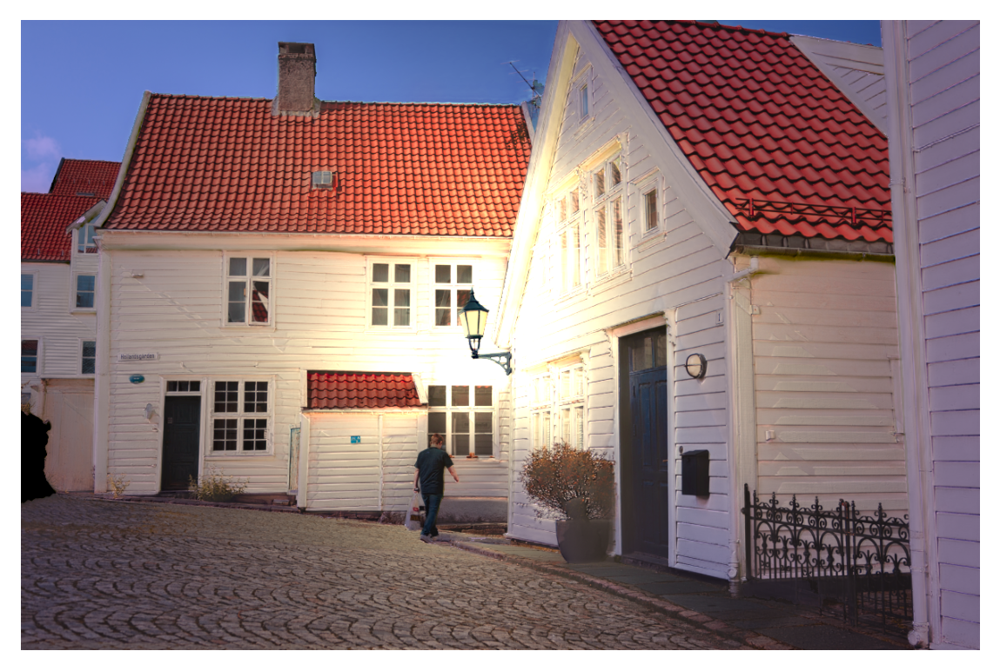

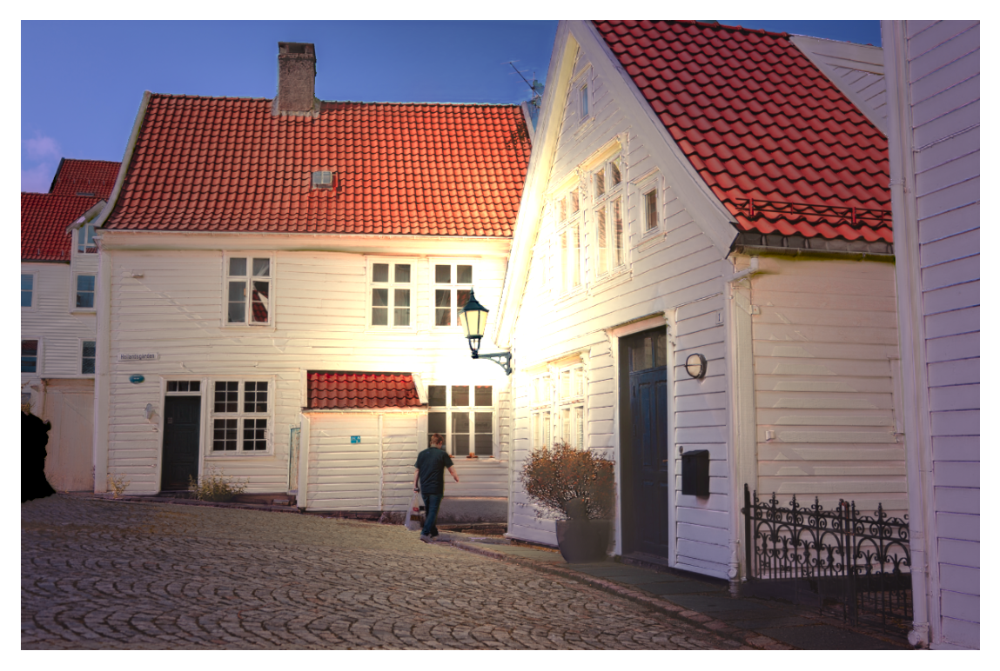

...

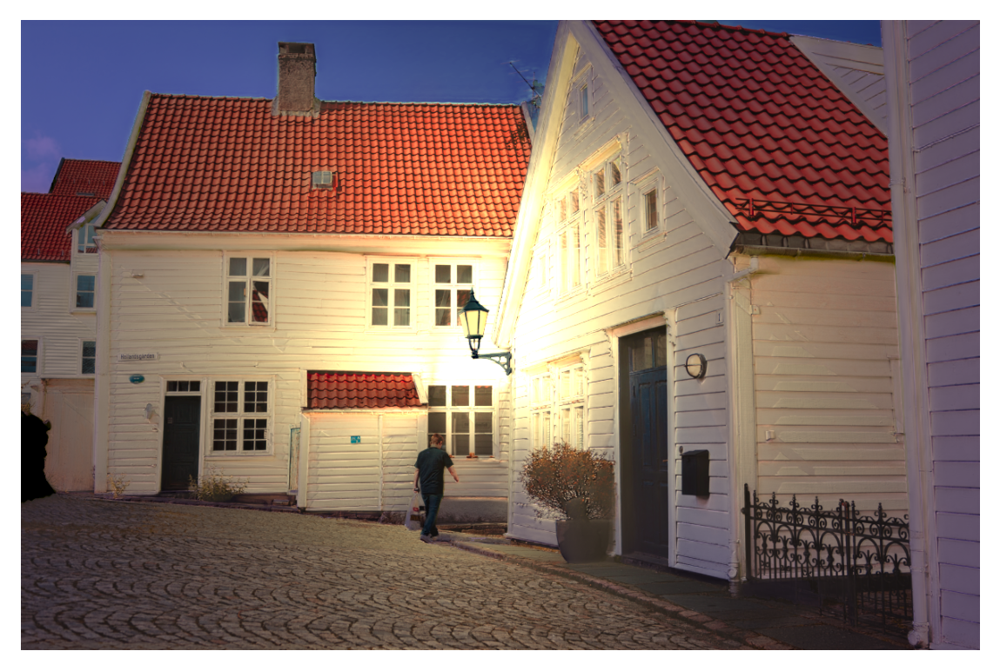

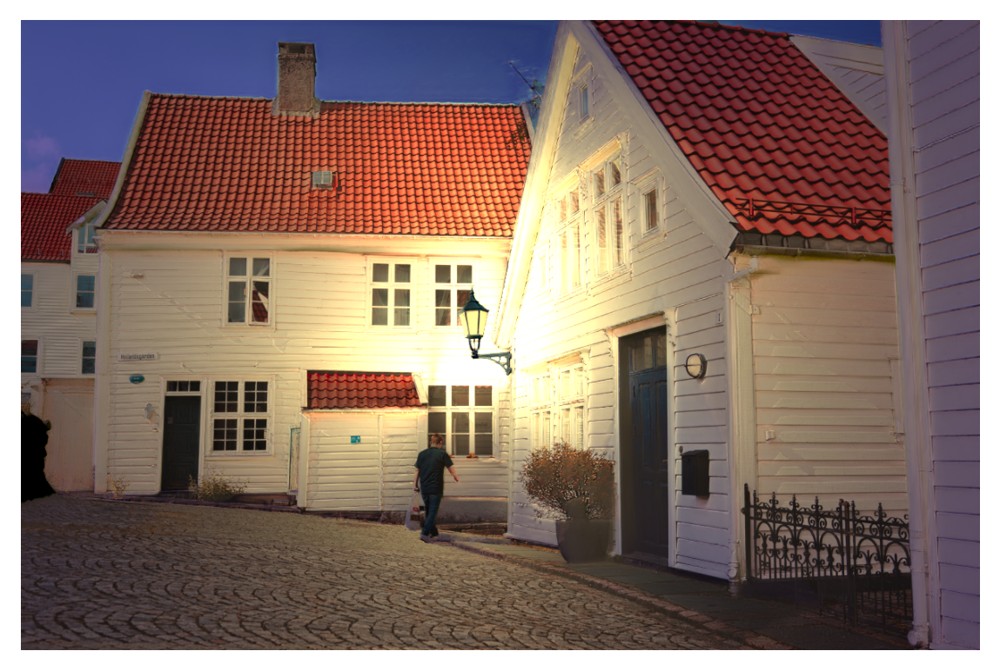

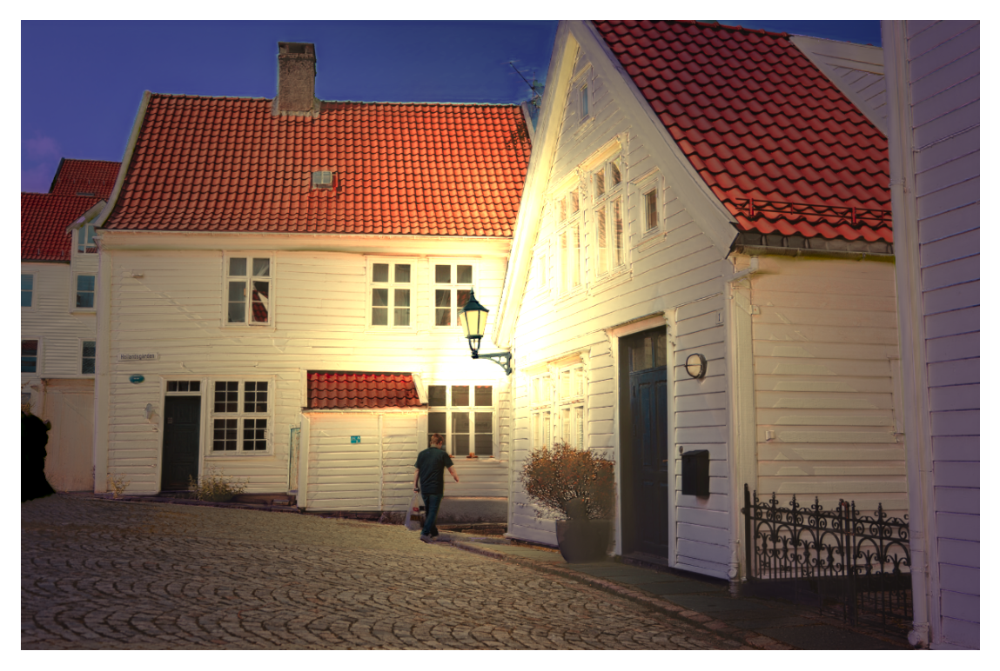

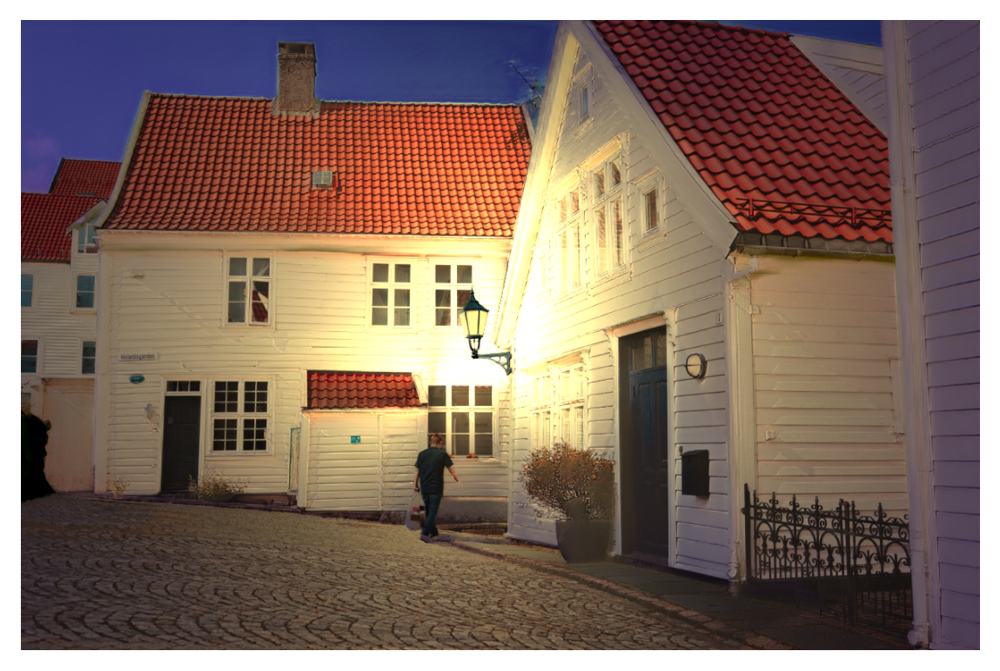

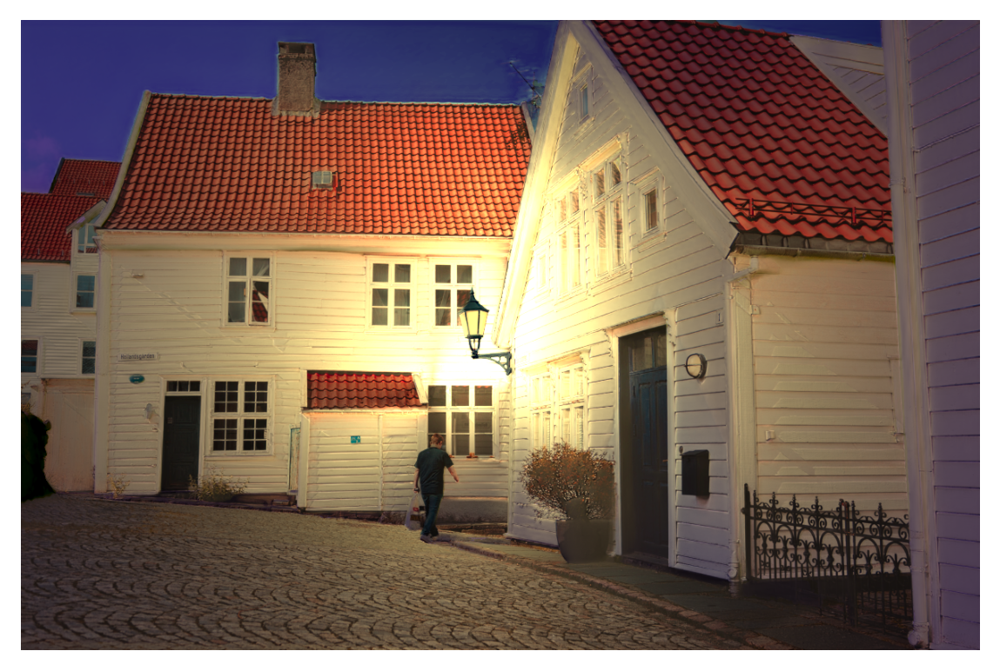

In [677]:
# INTERPOLATION example
# interpolationg between point light colors (p_colour) and ambient colors
timesteps = np.linspace(1, 0, num=16)

end_a_color = [0.051, 0.02, 0.129]
start_a_color = [0.329, 0.263, 0.51]

start_p_colour = [0.969, 0.847, 0.439]
end_p_colour = [1, 0.827, 0.267]

for i in range(len(timesteps)):
    point_colour = interpolate(start_p_colour, end_p_colour, timesteps[i])

    # CREATE POINT LIGHTS
    # light coordinates
    x = 620
    y = 250
    z = 100
    lights = np.array([
        [x, y, z], 
        [x, y + 50, z], 
        [x, y + 100, z], 
        [x, y + 150, z], 
        [x, y + 200, z], 
        [x - 100, y + 200, z]
    ])
    shadings = []
    shading_sum = np.zeros_like(image).astype('float64')

    for light in lights:
        light_vectors = point_light_3d(light, flat_vec_field)[1]
        shading = calculate_shading(light_vectors, normals, point_colour)
        shading_sum += np.abs(shading)
    
    # CREATE AMBIENT LIGHTS
    ambient_colour = interpolate(start_a_color, end_a_color, timesteps[i])
    path = (f'./data/{EXAMPLE_DIR}/')
    img = plt.imread(path + 'input.png')

    # Get the lights for each direction we want to use for ambient light
    top_light = get_new_light_dir([0, -1, 0], img)
    bottom_light = get_new_light_dir([0, 1, 0.3], img)
    left_light = get_new_light_dir([1, 0.3, 0.4], img)
    right_light = get_new_light_dir([-1, 0.3, 0.4], img)

    # Get the shading with each new light direction
    top_shading = get_shading(top_light, path, ambient_colour)
    bottom_shading = get_shading(bottom_light, path, ambient_colour)
    left_shading = get_shading(left_light, path, ambient_colour)
    right_shading = get_shading(right_light, path, ambient_colour)
    
    # COMBINE AMBIENT AND POINT LIGHTS

    shading = [top_shading, bottom_shading, left_shading, right_shading, shading_sum]
    multipliers = [0.4, 0.1, 0.1, 0.4, 7]

    shading = combine_shading(shading, multipliers)

    # Finally, create the image
    new_image = get_image(shading, path)

    f = plt.figure()
    f.set_dpi(240)
    plt.axis('off')
    plt.imshow(new_image)
    f.savefig(f'./results/1finland-changing-time{i+16}', dpi=240)